In [176]:
import qutip as qt
import numpy as np
import matplotlib.pyplot as plt

%config InlineBackend.figure_formats = ['svg']

# Coherent state ($N=1$)

(<Figure size 500x500 with 1 Axes>,
 <Axes: title={'center': 'Wigner function'}, xlabel='$\\rm{Re}(\\alpha)$', ylabel='$\\rm{Im}(\\alpha)$'>)

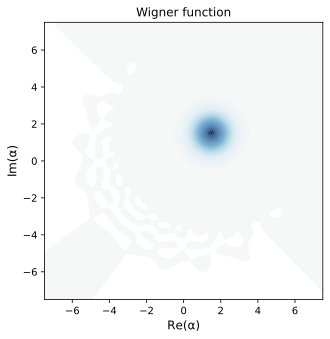

In [2]:
dim_fock = 100
a = qt.destroy(dim_fock)
alpha = 1.5 * np.exp(1j*np.pi/4) # cat size

vacuum_state = qt.fock(dim_fock, 0)
D_op = (alpha*a.dag()-np.conj(alpha)*a).expm()
coherent_state = D_op * vacuum_state

fig, ax = plt.subplots(ncols=1, figsize=(5, 5))
qt.plot_wigner(coherent_state, fig=fig, ax=ax)
# fig.savefig('./coherent_pi4.png', dpi=300)

(<Figure size 500x500 with 1 Axes>,
 <Axes: title={'center': 'Wigner function'}, xlabel='$\\rm{Re}(\\alpha)$', ylabel='$\\rm{Im}(\\alpha)$'>)

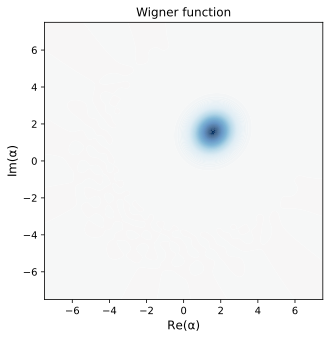

In [67]:
dim_fock = 100
a = qt.destroy(dim_fock)
alpha = 1.5  * np.exp(1j*np.pi/4) # cat size

vacuum_state = qt.fock(dim_fock, 0)

# Displacement
D_op = (alpha*a.dag()-np.conj(alpha)*a).expm()
coherent_state = D_op * vacuum_state

epsilon = 0.05 * np.exp(1j*(2*(np.pi/4+np.pi/2)))
# Squeezing
S_op = (np.conj(epsilon)/2*a**2 - epsilon/2*(a.dag())**2).expm()
squeezed_coherent_state = S_op * coherent_state

fig, ax = plt.subplots(ncols=1, figsize=(5, 5))
qt.plot_wigner(squeezed_coherent_state, fig=fig, ax=ax)
# fig.savefig('./squeezed_coherent_pi4.png', dpi=300)

(<Figure size 500x500 with 1 Axes>,
 <Axes: title={'center': 'Wigner function'}, xlabel='$\\rm{Re}(\\alpha)$', ylabel='$\\rm{Im}(\\alpha)$'>)

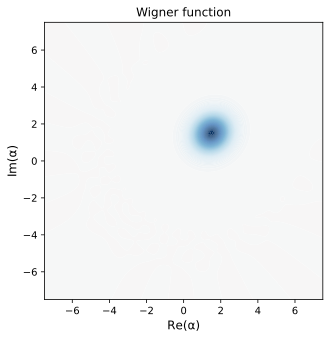

In [70]:
dim_fock = 100
a = qt.destroy(dim_fock)
vacuum_state = qt.fock(dim_fock, 0)

# Squeezing
epsilon = 0.05 * np.exp(1j*(2*(np.pi/4+np.pi/2)))
S_op = (np.conj(epsilon)/2*a**2 - epsilon/2*(a.dag())**2).expm()
squeezed_vacuum = S_op * vacuum_state

# # Displacement
alpha = 1.5 * np.exp(1j*np.pi/4)
D_op = (alpha*a.dag()-np.conj(alpha)*a).expm()
displaced_squeezed_vacuum = D_op * squeezed_vacuum

fig, ax = plt.subplots(ncols=1, figsize=(5, 5))
qt.plot_wigner(displaced_squeezed_vacuum, fig=fig, ax=ax)
#fig.savefig('./displaced_squeezed_vacuum_pi4.png', dpi=300)

In [71]:
qt.fidelity(squeezed_coherent_state, displaced_squeezed_vacuum)

0.9973276868389718

# Two-legged cat ($N=2$)

In [4]:
dim_fock = 100
a = qt.destroy(dim_fock)

def coherent_state(size, angle):
    '''
    Create a coherent state
    '''
    vacuum_state = qt.fock(dim_fock, 0)
    phi_alpha = angle
    alpha_val = size * np.exp(1j*phi_alpha)

    return (alpha_val*a.dag()-np.conj(alpha_val)*a).expm() * vacuum_state

even_cat = (coherent_state(4, 0)+coherent_state(4, np.pi)).unit()
odd_cat = ((1j*np.pi/2*a.dag()*a).expm()*(coherent_state(4, 0)-coherent_state(4, np.pi))).unit()
what_cat_is_this = (even_cat + odd_cat).unit()

fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(12, 4))
qt.plot_wigner(even_cat, fig=fig, ax=ax1)
qt.plot_wigner(odd_cat, fig=fig, ax=ax2)
qt.plot_wigner(what_cat_is_this, fig=fig, ax=ax3)
fig.tight_layout()

# $N=3$. What do we have?

In [177]:
import math

def log_factorial(k):
    if k == 0:
        return 1
    else:
        return math.lgamma(k + 1)

In [178]:
np.exp(math.lgamma(3 + 1))

6.0

In [179]:
dim_fock = 200

In [184]:
alpha = 5
first_coherent_state = qt.coherent(dim_fock, alpha)
second_coherent_state = qt.coherent(dim_fock, alpha*np.exp(1j*2*np.pi/3))
third_coherent_state = qt.coherent(dim_fock, alpha*np.exp(1j*4*np.pi/3))

N3_cat = (3*(1+2*np.exp(-3*alpha**2/2)*np.cos(np.sqrt(3)*alpha**2/2)))**(-1/2)

state = (first_coherent_state + second_coherent_state + third_coherent_state)
state_norm = N3_cat * state 
state_qutip_norm = state.unit()

In [185]:
state_norm.dag() * qt.destroy(dim_fock).dag()*qt.destroy(dim_fock) * state_norm

Quantum object: dims = [[1], [1]], shape = (1, 1), type = bra
Qobj data =
[[25.]]

In [186]:
alpha**2*(1-2*np.exp(-alpha**2/2)*np.sin(np.sqrt(3)*alpha**2/2+np.pi/6))/(1+2*np.exp(-3*alpha**2/2)*np.cos(np.sqrt(3)*alpha**2/2))

25.000033924499835

In [131]:
array1 = np.real(state_qutip_norm.full())
array1 = np.array([array1[i][0] for i in range(len(array1))])
array2 = np.real(state_norm.full())
array2 = np.array([array2[i][0] for i in range(len(array2))])

In [170]:
import math
def f(k):
    return 3*N3_cat*np.exp(-alpha**2/2)*alpha**(3*k)/np.sqrt(math.gamma((3*k)+1))

In [5]:
first_coherent_state = coherent_state(2, 0)
second_coherent_state = coherent_state(2, 2*np.pi/3)
third_coherent_state = coherent_state(2, 4*np.pi/3)

superimposed_state = (first_coherent_state + second_coherent_state + third_coherent_state).unit()
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, figsize=(12, 3))
qt.plot_wigner(first_coherent_state, fig=fig, ax=ax1, figsize=(3,3))
qt.plot_wigner(second_coherent_state, fig=fig, ax=ax2, figsize=(3,3))
qt.plot_wigner(third_coherent_state, fig=fig, ax=ax3, figsize=(3,3))
qt.plot_wigner(superimposed_state, fig=fig, ax=ax4, figsize=(3,3))
fig.tight_layout()

In [96]:
fock_0 = qt.fock(dim_fock, 0)
fock_2 = qt.fock(dim_fock, 2)
fock_4 = qt.fock(dim_fock, 4)

logical_0 = (fock_0 + fock_4)/np.sqrt(2)
logical_1 = fock_2

plus_state = (logical_0 + logical_1)/np.sqrt(2)
minus_state = (logical_0 - logical_1)/np.sqrt(2)

fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, figsize=(12, 3))
qt.plot_wigner(logical_0, fig=fig, ax=ax1, figsize=(3,3))
qt.plot_wigner(logical_1, fig=fig, ax=ax2, figsize=(3,3))
qt.plot_wigner(plus_state, fig=fig, ax=ax3, figsize=(3,3))
qt.plot_wigner(minus_state, fig=fig, ax=ax4, figsize=(3,3))
fig.tight_layout()


# SCS states

(<Figure size 500x500 with 1 Axes>,
 <Axes: title={'center': 'Wigner function'}, xlabel='$\\rm{Re}(\\alpha)$', ylabel='$\\rm{Im}(\\alpha)$'>)

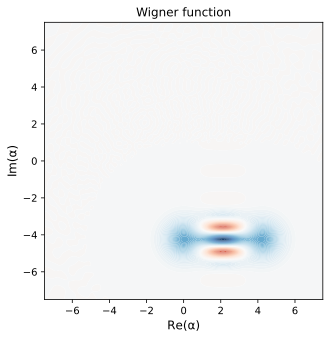

In [15]:
vacuum_state = qt.fock(dim_fock, 0)

alpha_state = coherent_state(3, 0)

alpha = 3 * np.exp(1j*(-np.pi/2))
SCS_state = (vacuum_state + alpha_state).unit()
SCS_state = (alpha * a.dag()-np.conj(alpha) * a).expm() * SCS_state

fig, ax = plt.subplots(ncols=1, figsize=(5,5))
qt.plot_wigner(SCS_state, fig=fig, ax=ax)